In [9]:
!source ~/root/bin/thisroot.sh

In [15]:
from lib import *
import numpy as np

import uproot
import os
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd

from plotly.subplots import make_subplots
from itertools import product

In [16]:
import uproot

# Open the ROOT file
root_file = uproot.open("../data/Digispe100eve_ideal_3gemu_hist.root")
hist = root_file["wavedigispe"].keys()
hist_idx_map = {h: i for i, h in enumerate(hist)}
# # Filter the histograms based on the condition
filtered_histograms = [h for h in hist if "event" in h and h.split("_")[3] == "434"]
# for h in filtered_histograms:
print([hist_idx_map[h] for h in filtered_histograms])


[1, 965, 1333, 2205, 2780, 3440, 4085, 4743, 5332, 6112, 6733, 6734, 7315, 8017, 8018, 8695, 9365, 10008, 10796, 10797, 11261, 11932, 11933, 12650, 13325, 13845, 14622, 15352, 15936, 16448, 17144, 17975, 17976, 18619, 18620, 19252, 19841, 20558, 21134, 21950, 21951, 22486, 23182, 23183, 23690, 24391, 24392, 25168, 25622, 26328, 26969, 27714, 27715, 28415, 29068, 29763, 30242, 30928, 31702, 32365, 32912, 33645, 34340, 34905, 34906, 35511, 35512, 36256, 36257, 36984, 36985, 37506, 38200, 38868, 39661, 40181, 40182, 40935, 41533, 41534, 42088, 42975, 42976, 43455, 43456, 44070, 44071, 44769, 45366, 45367, 46211, 46212, 46667, 46668, 47520, 48131, 48132, 48721, 48722, 49490, 50131, 50678, 50679, 51425, 51985, 52640, 53282, 54017, 54018, 54615, 54616, 55351, 55911, 56482, 57332, 57333, 57958, 58622, 59222, 59870, 60598, 61113, 61798, 61799, 62589, 62590, 63118, 63818, 64480, 65175]


In [16]:
digi = uproot.open("data/full_1rms/opdetraw_1rms_gen.root")
digi["EventMetaData"]["EventBranchEntryInfo"].keys()

[]

In [17]:
digi_wvfs = digi["Events"]["raw::OpDetWaveforms_opdigi__OpticalDigitization."]["raw::OpDetWaveforms_opdigi__OpticalDigitization.obj/raw::OpDetWaveforms_opdigi__OpticalDigitization.obj.vector<short>"]
digi_ch = digi["Events"]["raw::OpDetWaveforms_opdigi__OpticalDigitization."]["raw::OpDetWaveforms_opdigi__OpticalDigitization.obj/raw::OpDetWaveforms_opdigi__OpticalDigitization.obj.fChannel"]
digi_time = digi["Events"]["raw::OpDetWaveforms_opdigi__OpticalDigitization."]["raw::OpDetWaveforms_opdigi__OpticalDigitization.obj/raw::OpDetWaveforms_opdigi__OpticalDigitization.obj.fTimeStamp"]

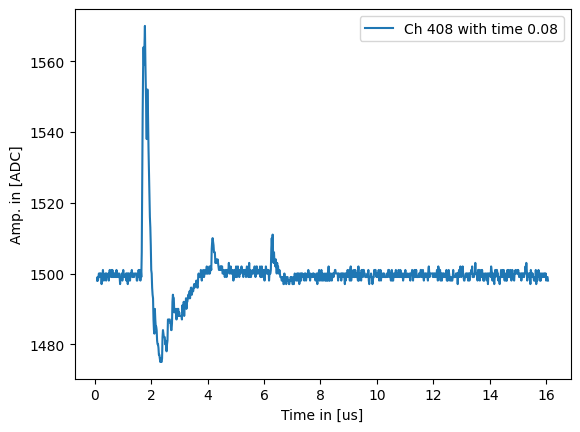

In [18]:
num = np.random.randint(len(digi_wvfs.array()[0]))
this_wvf = digi_wvfs.array()[0][num]
this_time = digi_time.array()[0][num]
this_ch = digi_ch.array()[0][num]
plt.plot(16e-3*np.arange(len(this_wvf))+this_time,this_wvf,label="Ch %i with time %.2f"%(this_ch,this_time))
plt.xlabel("Time in [us]")
plt.ylabel("Amp. in [ADC]")
plt.legend()
plt.show()


In [19]:
deco = uproot.open("data/full_1rms/deconv_gauss_gen.root")
deco["Events"]["recob::OpWaveforms_opdec__DecReco."].keys()

['recob::OpWaveforms_opdec__DecReco.present',
 'recob::OpWaveforms_opdec__DecReco.rangeSetID',
 'recob::OpWaveforms_opdec__DecReco.obj',
 'recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fTimeStamp.fTimeStamp',
 'recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fTimeStamp.fFlags',
 'recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fChannel',
 'recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fSignalROI.nominal_size',
 'recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fSignalROI.ranges']

In [20]:
deco_wvfs = deco["Events"]["recob::OpWaveforms_opdec__DecReco."]['recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fSignalROI.ranges']
deco_ch = deco["Events"]["recob::OpWaveforms_opdec__DecReco."]['recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fChannel']
deco_time = deco["Events"]["recob::OpWaveforms_opdec__DecReco."]['recob::OpWaveforms_opdec__DecReco.obj/recob::OpWaveforms_opdec__DecReco.obj.fTimeStamp.fTimeStamp']

In [27]:
deco_wvfs.debug(0)
print(deco_wvfs.array())

--+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+-
 64  29 148   6  64   9   0   0  24 116 116 221   0   0   0   1   0   0   0   0
  @ --- --- ---   @ --- --- --- ---   t   t --- --- --- --- --- --- --- --- ---
--+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+-
  0   0   0   0   0   0   0   0   0   0   3 232  64   0  15 166   0   9   0   0
--- --- --- --- --- --- --- --- --- --- --- ---   @ --- --- --- --- --- --- ---
--+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+-
  3 232 189 125 107  18 189  30 207  45 189 150  13  11 188 168 111 108  61  99
--- --- ---   }   k --- --- --- ---   - --- --- --- --- --- ---   o   l   =   c
--+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+---+-
 27 222  61 244 122  81 189 125  28  86  60 181 231 254  61 178 116  63  60 153
--- ---   = ---   z   Q ---   } ---   V   < --- --- ---   = ---   t   ?   < ---
--+---+---+---+---+---+---+---+---+-

ValueError: invalid C++ type name syntax at char 35

    vector<lar::sparse_vector<float>::datarange_t>
---------------------------------------^
in file data/full_1rms/deconv_gauss_gen.root

In [14]:
num = np.random.randint(len(deco_wvfs.array()[0]))
this_wvf = deco_wvfs.array()[0][num]
this_time = deco_time.array()[0][num]
this_ch = deco_ch.array()[0][num]
plt.plot(16e-3*np.arange(len(this_wvf))+this_time,this_wvf,label="Ch %i with time %.2f"%(this_ch,this_time))
plt.xlabel("Time in [us]")
plt.ylabel("Amp. in [ADC]")
plt.legend()
plt.show()

ValueError: invalid C++ type name syntax at char 35

    vector<lar::sparse_vector<float>::datarange_t>
---------------------------------------^
in file data/full_1rms/deconv_gauss_gen.root